In [1]:
# !pip install openvino-dev
# !pip install distinctipy

In [2]:
from icevision.all import *

INFO     - The mmdet config folder already exists. No need to downloaded it. Path : /home/innom-dt/.icevision/mmdetection_configs/mmdetection_configs-2.16.0/configs | icevision.models.mmdet.download_configs:download_mmdet_configs:17


In [3]:
import pandas as pd
pd.set_option('max_colwidth', None)
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

In [4]:
import inspect

def inspect_default_args(target, annotations: bool=False):
    # Get the argument names
    args = inspect.getfullargspec(target).args
    # Get the default values
    defaults = inspect.getfullargspec(target).defaults

    index = ["Default Value"]

    # Pad defaults
    defaults = [None]*(len(args)-len(defaults)) + list(defaults)
    if annotations:
        index.append("Annotation")
        annotations = inspect.getfullargspec(target).annotations.values()
        # Pad annotations
        annotations = [None]*(len(args)-len(annotations)) + list(annotations)
        default_args = {arg:[df, annot] for arg,df,annot in zip(args, defaults, annotations)}
    else:
        default_args = {arg:[default] for arg,default in zip(args, defaults)}
        
    return pd.DataFrame(default_args, index=index).T


**Define path to dataset**

In [5]:
# archive_dir = Path('/mnt/980SSD/Datasets/archive')
# dataset_dir = archive_dir/'../data'
# dataset_url = "https://cvbp-secondary.z19.web.core.windows.net/datasets/object_detection/odFridgeObjects.zip"
# dataset_path = dataset_dir/'fridge'
# dataset_path

In [6]:
# dataset_dir = Path('/mnt/980SSD/Datasets')
# dataset_path = dataset_dir/'COCO_2014'
# dataset_path

In [7]:
# dataset_dir = Path('/mnt/980SSD/Datasets')
# dataset_path = dataset_dir/'American Sign Language Letters_COCO'
# dataset_path

**Download the dataset**

In [8]:
# icedata.load_data(dataset_url, dataset_path)

In [9]:
dataset_path = icedata.voc.load_data()
dataset_path

Path('/home/innom-dt/.icevision/data/voc')

**Inspect the dataset path**

In [10]:
pd.DataFrame(list(dataset_path.ls()))

,0
0,/home/innom-dt/.icevision/data/voc/Annotations
1,/home/innom-dt/.icevision/data/voc/SegmentationClass
2,/home/innom-dt/.icevision/data/voc/SegmentationObject
3,/home/innom-dt/.icevision/data/voc/JPEGImages
4,/home/innom-dt/.icevision/data/voc/trainval.tar
5,/home/innom-dt/.icevision/data/voc/ImageSets


**Get image file paths**

In [11]:
files = get_image_files(dataset_path)
len(files)

22951

**Inspect files**

In [12]:
pd.DataFrame([files[0], files[-1]])

,0
0,/home/innom-dt/.icevision/data/voc/JPEGImages/2007_000027.jpg
1,/home/innom-dt/.icevision/data/voc/SegmentationObject/2011_003271.png


**Inspect one of the training images**

Image Dims: (500, 486)


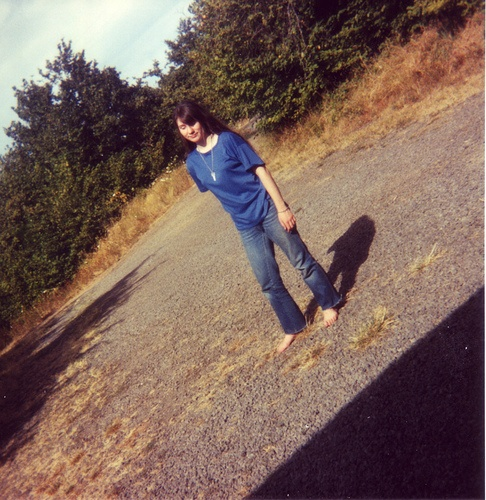

In [13]:
import PIL
img = PIL.Image.open(files[0])
print(f"Image Dims: {img.shape}")
img

**Create the BBOX parser**

In [14]:
# parser = parsers.VOCBBoxParser(annotations_dir=dataset_path/"odFridgeObjects/annotations", 
#                                images_dir=dataset_path/"odFridgeObjects/images")

In [15]:
# Get the class_map, a utility that maps from number IDs to classs names
class_map = icedata.voc.class_map()

parser = parsers.VOCBBoxParser(annotations_dir=dataset_path/"Annotations", 
                               images_dir=dataset_path/"JPEGImages", class_map=class_map)

In [16]:
# # Get the class_map, a utility that maps from number IDs to classs names
# class_map = icedata.coco.class_map()

# parser = icedata.coco.parser_bbox(annotations_filepath=dataset_path/"instances_train2014.json", 
#                                img_dir=dataset_path/"train2014", idmap=class_map)

In [17]:
# # Get the class_map, a utility that maps from number IDs to classs names
# # class_map = icedata.coco.class_map()
# parser = icedata.coco.parser_bbox(annotations_filepath=dataset_path/'train/_annotations.coco.json', img_dir=dataset_path/"train")

**Parse annotations to create records**

In [18]:
# Randomly split our data into train/valid
data_splitter = RandomSplitter([0.8, 0.2])

train_records, valid_records = parser.parse(data_splitter)
parser.class_map

  0%|          | 0/17125 [00:00<?, ?it/s]

INFO     - Autofixing records | icevision.parsers.parser:parse:122


  0%|          | 0/17125 [00:00<?, ?it/s]

<ClassMap: {0: 0, 'aeroplane': 1, 'bicycle': 2, 'bird': 3, 'boat': 4, 'bottle': 5, 'bus': 6, 'car': 7, 'cat': 8, 'chair': 9, 'cow': 10, 'diningtable': 11, 'dog': 12, 'horse': 13, 'motorbike': 14, 'person': 15, 'pottedplant': 16, 'sheep': 17, 'sofa': 18, 'train': 19, 'tvmonitor': 20}>

**Note:** The `background` class is not included in the final model.

**Select a multiple of 128 as the input resolution**

In [19]:
[128*i for i in range(1,6)]

[128, 256, 384, 512, 640]

In [20]:
image_size = 384

**Define Transforms**

In [21]:
train_tfms = tfms.A.Adapter([*tfms.A.aug_tfms(size=image_size, presize=512), tfms.A.Normalize()])
valid_tfms = tfms.A.Adapter([*tfms.A.resize_and_pad(image_size), tfms.A.Normalize()])

**Get normalization stats**

In [22]:
norm_args = inspect_default_args(tfms.A.Normalize)
norm_args

,Default Value
self,None
mean,"(0.485, 0.456, 0.406)"
std,"(0.229, 0.224, 0.225)"
max_pixel_value,255
always_apply,False
p,1


In [23]:
mean = norm_args['Default Value']['mean']
std = norm_args['Default Value']['std']
mean, std

((0.485, 0.456, 0.406), (0.229, 0.224, 0.225))

**Define Datasets**

In [24]:
train_ds = Dataset(train_records, train_tfms)
valid_ds = Dataset(valid_records, valid_tfms)
train_ds, valid_ds

(<Dataset with 13700 items>, <Dataset with 3425 items>)

**Apply augmentations to a training sample**

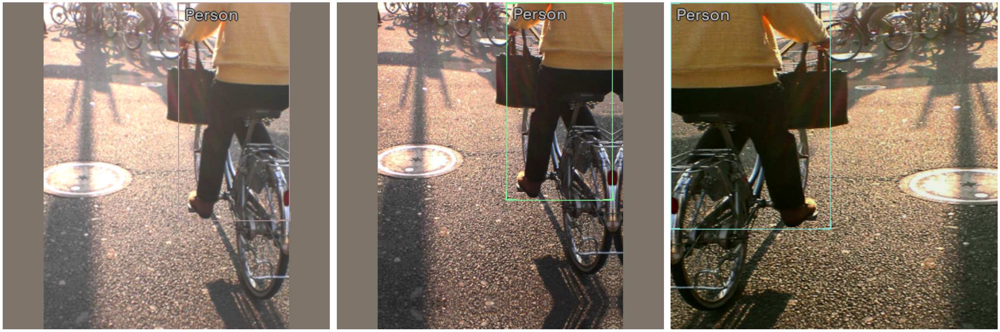

In [25]:
samples = [train_ds[0] for _ in range(3)]
show_samples(samples, ncols=3)

**Define model type**

In [26]:
# model_type = models.mmdet.retinanet
model_type = models.mmdet.yolox

**Define backbone**

In [27]:
backbone = model_type.backbones.yolox_tiny_8x8(pretrained=True)
pd.DataFrame.from_dict(backbone.__dict__, orient='index')

,0
model_name,yolox
config_path,/home/innom-dt/.icevision/mmdetection_configs/mmdetection_configs-2.16.0/configs/yolox/yolox_tiny_8x8_300e_coco.py
weights_url,https://download.openmmlab.com/mmdetection/v2.0/yolox/yolox_tiny_8x8_300e_coco/yolox_tiny_8x8_300e_coco_20210806_234250-4ff3b67e.pth
pretrained,True


In [28]:
import mmcv
cfg = mmcv.Config.fromfile(backbone.config_path)
pd.DataFrame(pd.DataFrame.from_dict(cfg.__dict__)['_cfg_dict'])

,_cfg_dict
checkpoint_config,{'interval': 10}
custom_hooks,"[{'type': 'YOLOXModeSwitchHook', 'num_last_epochs': 15, 'priority': 48}, {'type': 'SyncRandomSizeHook', 'ratio_range': (10, 20), 'img_scale': (640, 640), 'interval': 10, 'priority': 48}, {'type': 'SyncNormHook', 'num_last_epochs': 15, 'interval': 10, 'priority': 48}, {'type': 'ExpMomentumEMAHook', 'resume_from': None, 'priority': 49}]"
data,"{'samples_per_gpu': 8, 'workers_per_gpu': 2, 'train': {'type': 'MultiImageMixDataset', 'dataset': {'type': 'CocoDataset', 'ann_file': 'data/coco/annotations/instances_train2017.json', 'img_prefix': 'data/coco/train2017/', 'pipeline': [{'type': 'LoadImageFromFile', 'to_float32': True}, {'type': 'LoadAnnotations', 'with_bbox': True}], 'filter_empty_gt': False}, 'pipeline': [{'type': 'Mosaic', 'img_scale': (640, 640), 'pad_val': 114.0}, {'type': 'RandomAffine', 'scaling_ratio_range': (0.5, 1.5), 'border': (-320, -320)}, {'type': 'PhotoMetricDistortion', 'brightness_delta': 32, 'contrast_range': (0.5, 1.5), 'saturation_range': (0.5, 1.5), 'hue_delta': 18}, {'type': 'RandomFlip', 'flip_ratio': 0.5}, {'type': 'Resize', 'keep_ratio': True}, {'type': 'Pad', 'pad_to_square': True, 'pad_val': 114.0}, {'type': 'Normalize', 'mean': [123.675, 116.28, 103.53], 'std': [58.395, 57.12, 57.375], 'to_rgb': True}, {'type': 'DefaultFormatBundle'}, {'type': 'Collect', 'keys': ['img', 'gt_bboxes', 'gt_labels']}], 'dynamic_scale': (640, 640)}, 'val': {'type': 'CocoDataset', 'ann_file': 'data/coco/annotations/instances_val2017.json', 'img_prefix': 'data/coco/val2017/', 'pipeline': [{'type': 'LoadImageFromFile'}, {'type': 'MultiScaleFlipAug', 'img_scale': (416, 416), 'flip': False, 'transforms': [{'type': 'Resize', 'keep_ratio': True}, {'type': 'RandomFlip'}, {'type': 'Pad', 'size': (416, 416), 'pad_val': 114.0}, {'type': 'Normalize', 'mean': [123.675, 116.28, 103.53], 'std': [58.395, 57.12, 57.375], 'to_rgb': True}, {'type': 'DefaultFormatBundle'}, {'type': 'Collect', 'keys': ['img']}]}]}, 'test': {'type': 'CocoDataset', 'ann_file': 'data/coco/annotations/instances_val2017.json', 'img_prefix': 'data/coco/val2017/', 'pipeline': [{'type': 'LoadImageFromFile'}, {'type': 'MultiScaleFlipAug', 'img_scale': (416, 416), 'flip': False, 'transforms': [{'type': 'Resize', 'keep_ratio': True}, {'type': 'RandomFlip'}, {'type': 'Pad', 'size': (416, 416), 'pad_val': 114.0}, {'type': 'Normalize', 'mean': [123.675, 116.28, 103.53], 'std': [58.395, 57.12, 57.375], 'to_rgb': True}, {'type': 'DefaultFormatBundle'}, {'type': 'Collect', 'keys': ['img']}]}]}}"
data_root,data/coco/
dataset_type,CocoDataset
dist_params,{'backend': 'nccl'}
evaluation,"{'interval': 10, 'metric': 'bbox'}"
img_norm_cfg,"{'mean': [123.675, 116.28, 103.53], 'std': [58.395, 57.12, 57.375], 'to_rgb': True}"
img_scale,"(640, 640)"
interval,10


**Define batch size**

In [29]:
bs = 32

**Define DataLoaders**

In [30]:
train_dl = model_type.train_dl(train_ds, batch_size=bs, num_workers=8, shuffle=True)
valid_dl = model_type.valid_dl(valid_ds, batch_size=bs, num_workers=8, shuffle=False)

**Verify DataLoaders**

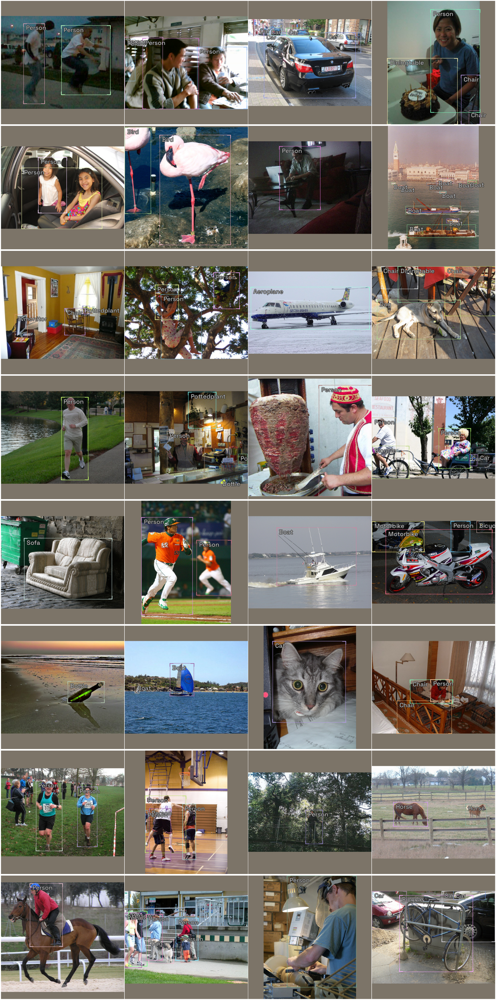

In [31]:
model_type.show_batch(first(valid_dl), ncols=4)

**Instantiate the model**

In [32]:
extra_args = {}

In [33]:
model = model_type.model(backbone=backbone(pretrained=True), num_classes=len(parser.class_map), **extra_args) 

2022-07-21 10:17:23,771 - mmcv - INFO - initialize CSPDarknet with init_cfg {'type': 'Kaiming', 'layer': 'Conv2d', 'a': 2.23606797749979, 'distribution': 'uniform', 'mode': 'fan_in', 'nonlinearity': 'leaky_relu'}
2022-07-21 10:17:23,786 - mmcv - INFO - initialize YOLOXPAFPN with init_cfg {'type': 'Kaiming', 'layer': 'Conv2d', 'a': 2.23606797749979, 'distribution': 'uniform', 'mode': 'fan_in', 'nonlinearity': 'leaky_relu'}
2022-07-21 10:17:23,797 - mmcv - INFO - initialize YOLOXHead with init_cfg {'type': 'Kaiming', 'layer': 'Conv2d', 'a': 2.23606797749979, 'distribution': 'uniform', 'mode': 'fan_in', 'nonlinearity': 'leaky_relu'}
2022-07-21 10:17:23,804 - mmcv - INFO - 
backbone.stem.conv.conv.weight - torch.Size([24, 12, 3, 3]): 
KaimingInit: a=2.23606797749979, mode=fan_in, nonlinearity=leaky_relu, distribution =uniform, bias=0 
 
2022-07-21 10:17:23,804 - mmcv - INFO - 
backbone.stem.conv.bn.weight - torch.Size([24]): 
The value is the same before and after calling `init_weights` of

2022-07-21 10:17:23,816 - mmcv - INFO - 
backbone.stage2.1.blocks.1.conv1.bn.bias - torch.Size([48]): 
The value is the same before and after calling `init_weights` of YOLOX  
 
2022-07-21 10:17:23,816 - mmcv - INFO - 
backbone.stage2.1.blocks.1.conv2.conv.weight - torch.Size([48, 48, 3, 3]): 
KaimingInit: a=2.23606797749979, mode=fan_in, nonlinearity=leaky_relu, distribution =uniform, bias=0 
 
2022-07-21 10:17:23,817 - mmcv - INFO - 
backbone.stage2.1.blocks.1.conv2.bn.weight - torch.Size([48]): 
The value is the same before and after calling `init_weights` of YOLOX  
 
2022-07-21 10:17:23,817 - mmcv - INFO - 
backbone.stage2.1.blocks.1.conv2.bn.bias - torch.Size([48]): 
The value is the same before and after calling `init_weights` of YOLOX  
 
2022-07-21 10:17:23,817 - mmcv - INFO - 
backbone.stage2.1.blocks.2.conv1.conv.weight - torch.Size([48, 48, 1, 1]): 
KaimingInit: a=2.23606797749979, mode=fan_in, nonlinearity=leaky_relu, distribution =uniform, bias=0 
 
2022-07-21 10:17:23,81

2022-07-21 10:17:23,827 - mmcv - INFO - 
backbone.stage4.1.conv1.bn.weight - torch.Size([192]): 
The value is the same before and after calling `init_weights` of YOLOX  
 
2022-07-21 10:17:23,827 - mmcv - INFO - 
backbone.stage4.1.conv1.bn.bias - torch.Size([192]): 
The value is the same before and after calling `init_weights` of YOLOX  
 
2022-07-21 10:17:23,828 - mmcv - INFO - 
backbone.stage4.1.conv2.conv.weight - torch.Size([384, 768, 1, 1]): 
KaimingInit: a=2.23606797749979, mode=fan_in, nonlinearity=leaky_relu, distribution =uniform, bias=0 
 
2022-07-21 10:17:23,828 - mmcv - INFO - 
backbone.stage4.1.conv2.bn.weight - torch.Size([384]): 
The value is the same before and after calling `init_weights` of YOLOX  
 
2022-07-21 10:17:23,828 - mmcv - INFO - 
backbone.stage4.1.conv2.bn.bias - torch.Size([384]): 
The value is the same before and after calling `init_weights` of YOLOX  
 
2022-07-21 10:17:23,828 - mmcv - INFO - 
backbone.stage4.2.main_conv.conv.weight - torch.Size([192, 38

2022-07-21 10:17:23,837 - mmcv - INFO - 
neck.top_down_blocks.1.main_conv.bn.bias - torch.Size([48]): 
The value is the same before and after calling `init_weights` of YOLOX  
 
2022-07-21 10:17:23,837 - mmcv - INFO - 
neck.top_down_blocks.1.short_conv.conv.weight - torch.Size([48, 192, 1, 1]): 
KaimingInit: a=2.23606797749979, mode=fan_in, nonlinearity=leaky_relu, distribution =uniform, bias=0 
 
2022-07-21 10:17:23,837 - mmcv - INFO - 
neck.top_down_blocks.1.short_conv.bn.weight - torch.Size([48]): 
The value is the same before and after calling `init_weights` of YOLOX  
 
2022-07-21 10:17:23,838 - mmcv - INFO - 
neck.top_down_blocks.1.short_conv.bn.bias - torch.Size([48]): 
The value is the same before and after calling `init_weights` of YOLOX  
 
2022-07-21 10:17:23,838 - mmcv - INFO - 
neck.top_down_blocks.1.final_conv.conv.weight - torch.Size([96, 96, 1, 1]): 
KaimingInit: a=2.23606797749979, mode=fan_in, nonlinearity=leaky_relu, distribution =uniform, bias=0 
 
2022-07-21 10:17:

2022-07-21 10:17:23,846 - mmcv - INFO - 
neck.bottom_up_blocks.1.blocks.0.conv1.conv.weight - torch.Size([192, 192, 1, 1]): 
KaimingInit: a=2.23606797749979, mode=fan_in, nonlinearity=leaky_relu, distribution =uniform, bias=0 
 
2022-07-21 10:17:23,846 - mmcv - INFO - 
neck.bottom_up_blocks.1.blocks.0.conv1.bn.weight - torch.Size([192]): 
The value is the same before and after calling `init_weights` of YOLOX  
 
2022-07-21 10:17:23,850 - mmcv - INFO - 
neck.bottom_up_blocks.1.blocks.0.conv1.bn.bias - torch.Size([192]): 
The value is the same before and after calling `init_weights` of YOLOX  
 
2022-07-21 10:17:23,851 - mmcv - INFO - 
neck.bottom_up_blocks.1.blocks.0.conv2.conv.weight - torch.Size([192, 192, 3, 3]): 
KaimingInit: a=2.23606797749979, mode=fan_in, nonlinearity=leaky_relu, distribution =uniform, bias=0 
 
2022-07-21 10:17:23,851 - mmcv - INFO - 
neck.bottom_up_blocks.1.blocks.0.conv2.bn.weight - torch.Size([192]): 
The value is the same before and after calling `init_weigh

2022-07-21 10:17:23,861 - mmcv - INFO - 
bbox_head.multi_level_reg_convs.1.1.bn.weight - torch.Size([96]): 
The value is the same before and after calling `init_weights` of YOLOX  
 
2022-07-21 10:17:23,861 - mmcv - INFO - 
bbox_head.multi_level_reg_convs.1.1.bn.bias - torch.Size([96]): 
The value is the same before and after calling `init_weights` of YOLOX  
 
2022-07-21 10:17:23,862 - mmcv - INFO - 
bbox_head.multi_level_reg_convs.2.0.conv.weight - torch.Size([96, 96, 3, 3]): 
KaimingInit: a=2.23606797749979, mode=fan_in, nonlinearity=leaky_relu, distribution =uniform, bias=0 
 
2022-07-21 10:17:23,862 - mmcv - INFO - 
bbox_head.multi_level_reg_convs.2.0.bn.weight - torch.Size([96]): 
The value is the same before and after calling `init_weights` of YOLOX  
 
2022-07-21 10:17:23,862 - mmcv - INFO - 
bbox_head.multi_level_reg_convs.2.0.bn.bias - torch.Size([96]): 
The value is the same before and after calling `init_weights` of YOLOX  
 
2022-07-21 10:17:23,862 - mmcv - INFO - 
bbox_he

Use load_from_local loader
The model and loaded state dict do not match exactly

size mismatch for bbox_head.multi_level_conv_cls.0.weight: copying a param with shape torch.Size([80, 96, 1, 1]) from checkpoint, the shape in current model is torch.Size([20, 96, 1, 1]).
size mismatch for bbox_head.multi_level_conv_cls.0.bias: copying a param with shape torch.Size([80]) from checkpoint, the shape in current model is torch.Size([20]).
size mismatch for bbox_head.multi_level_conv_cls.1.weight: copying a param with shape torch.Size([80, 96, 1, 1]) from checkpoint, the shape in current model is torch.Size([20, 96, 1, 1]).
size mismatch for bbox_head.multi_level_conv_cls.1.bias: copying a param with shape torch.Size([80]) from checkpoint, the shape in current model is torch.Size([20]).
size mismatch for bbox_head.multi_level_conv_cls.2.weight: copying a param with shape torch.Size([80, 96, 1, 1]) from checkpoint, the shape in current model is torch.Size([20, 96, 1, 1]).
size mismatch for bbox_

**Define metrics**

In [34]:
metrics = [COCOMetric(metric_type=COCOMetricType.bbox)]

**Define Learner object**

In [35]:
learn = model_type.fastai.learner(dls=[train_dl, valid_dl], model=model, metrics=metrics)

**Find learning rate**

SuggestedLRs(valley=0.0004786300996784121)

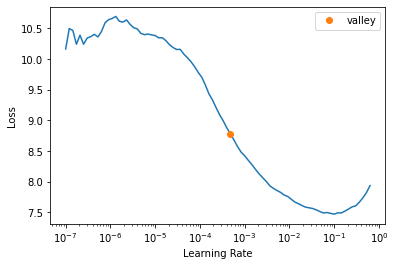

In [36]:
learn.lr_find()

**Define learning rate**

In [37]:
# lr = 1e-3
lr = 3e-4

**Define number of epochs**

In [38]:
epochs = 20

**Finetune model**

In [39]:
learn.fine_tune(epochs, lr, freeze_epochs=1)

epoch,train_loss,valid_loss,COCOMetric,time
0,4.550391,4.355423,0.401638,02:00


epoch,train_loss,valid_loss,COCOMetric,time
0,4.192836,3.941809,0.446881,02:05
1,4.088256,3.914684,0.453356,02:10
2,4.026396,3.893631,0.439593,02:11
3,4.103260,4.159912,0.416364,02:11
4,4.055859,3.992611,0.440080,02:09
5,3.934843,4.076243,0.424090,02:09
6,3.899306,4.142241,0.419688,02:24
7,3.949005,4.091710,0.421043,02:12
8,3.792656,3.950817,0.448244,02:13
9,3.656800,3.948714,0.439978,02:14


**Create an inference dataloader using the validation set**

In [40]:
infer_dl = model_type.infer_dl(valid_ds, batch_size=4, shuffle=False)

**Get model predictions**

  0%|          | 0/857 [00:00<?, ?it/s]

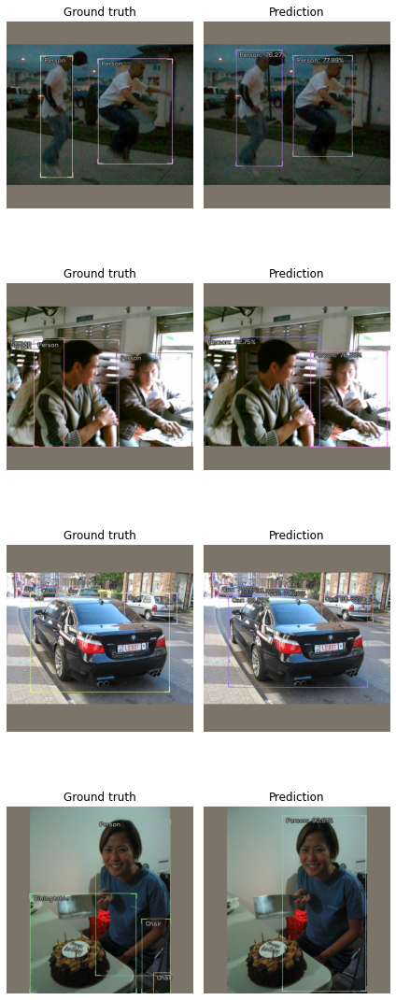

In [41]:
preds = model_type.predict_from_dl(model, infer_dl, keep_images=True)
show_preds(preds=preds[:4])

**Define method to convert a PIL Image to a Pytorch Tensor**

In [42]:
def img_to_tensor(img:PIL.Image, mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]):
    # Convert image to tensor
    img_tensor = torch.Tensor(np.array(img)).permute(2, 0, 1)
    # Scale pixels values from [0,255] to [0,1]
    scaled_tensor = img_tensor.float().div_(255)
    # Prepare normalization tensors
    mean_tensor = tensor(mean).view(1,1,-1).permute(2, 0, 1)
    std_tensor = tensor(std).view(1,1,-1).permute(2, 0, 1)
    # Normalize tensor    
    normalized_tensor = (scaled_tensor - mean_tensor) / std_tensor
    # Batch tensor
    return normalized_tensor.unsqueeze(dim=0)

**Select a test image**

In [43]:
test_file = files[0]
test_file.name

'2007_000027.jpg'

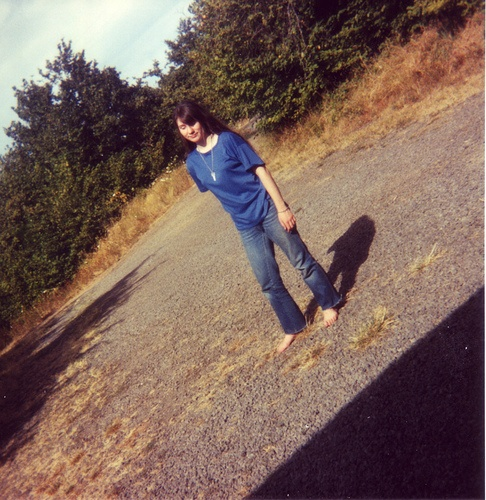

In [44]:
test_img = PIL.Image.open(test_file).convert('RGB')
test_img

In [45]:
# stride_val = 128
stride_val = 32

In [46]:
input_h = test_img.height - (test_img.height % stride_val)
input_w = test_img.width - (test_img.width % stride_val)
input_h, input_w

(480, 480)

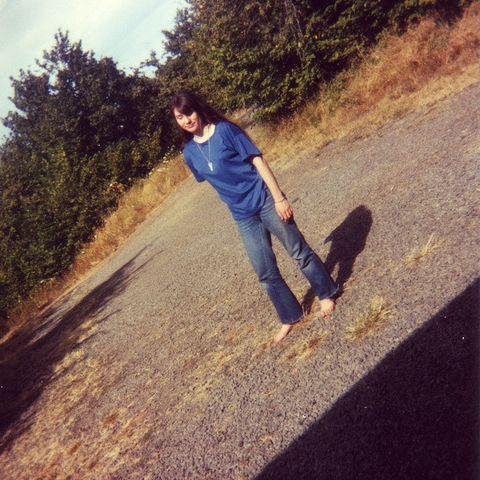

In [47]:
test_img = test_img.crop_pad((input_w, input_h))
# test_img = test_img.resize((input_w, input_h))
test_img

In [48]:
test_tensor = img_to_tensor(test_img, mean=mean, std=std)
test_tensor.shape

torch.Size([1, 3, 480, 480])

In [49]:
origin_forward = model.forward

In [50]:
model.forward = model.forward_dummy

In [51]:
model_output = model.cpu()(test_tensor.cpu())

In [52]:
for raw_out in model_output:
    for out in raw_out:
        print(out.shape)

torch.Size([1, 20, 60, 60])
torch.Size([1, 20, 30, 30])
torch.Size([1, 20, 15, 15])
torch.Size([1, 4, 60, 60])
torch.Size([1, 4, 30, 30])
torch.Size([1, 4, 15, 15])
torch.Size([1, 1, 60, 60])
torch.Size([1, 1, 30, 30])
torch.Size([1, 1, 15, 15])


In [53]:
def forward_export(self, input_tensor):
    # Get raw model output
    model_output = self.forward_dummy(input_tensor.cpu())
    # Extract class scores
    cls_scores = model_output[0]
    # Extract bounding box predictions
    bbox_preds = model_output[1]
    # Extract objectness scores
    objectness = model_output[2]
    
    stride_8_cls = torch.sigmoid(cls_scores[0])
    stride_8_bbox = bbox_preds[0]
    stride_8_objectness = torch.sigmoid(objectness[0])
#     stride_8_cat = torch.cat((stride_8_cls, stride_8_bbox, stride_8_objectness), dim=1)
    stride_8_cat = torch.cat((stride_8_bbox, stride_8_objectness, stride_8_cls), dim=1)
    stride_8_flat = torch.flatten(stride_8_cat, start_dim=2)

    stride_16_cls = torch.sigmoid(cls_scores[1])
    stride_16_bbox = bbox_preds[1]
    stride_16_objectness = torch.sigmoid(objectness[1])
#     stride_16_cat = torch.cat((stride_16_cls, stride_16_bbox, stride_16_objectness), dim=1)
    stride_16_cat = torch.cat((stride_16_bbox, stride_16_objectness, stride_16_cls), dim=1)
    stride_16_flat = torch.flatten(stride_16_cat, start_dim=2)

    stride_32_cls = torch.sigmoid(cls_scores[2])
    stride_32_bbox = bbox_preds[2]
    stride_32_objectness = torch.sigmoid(objectness[2])
#     stride_32_cat = torch.cat((stride_32_cls, stride_32_bbox, stride_32_objectness), dim=1)
    stride_32_cat = torch.cat((stride_32_bbox, stride_32_objectness, stride_32_cls), dim=1)
    stride_32_flat = torch.flatten(stride_32_cat, start_dim=2)

    full_cat = torch.cat((stride_8_flat, stride_16_flat, stride_32_flat), dim=2)

    return full_cat.permute(0, 2, 1)

In [54]:
model.forward_export = forward_export.__get__(model)

In [55]:
model.forward_export(test_tensor).shape

torch.Size([1, 4725, 25])

In [56]:
model.forward = model.forward_export

In [57]:
model(test_tensor).shape

torch.Size([1, 4725, 25])

In [58]:
parser.class_map

<ClassMap: {0: 0, 'aeroplane': 1, 'bicycle': 2, 'bird': 3, 'boat': 4, 'bottle': 5, 'bus': 6, 'car': 7, 'cat': 8, 'chair': 9, 'cow': 10, 'diningtable': 11, 'dog': 12, 'horse': 13, 'motorbike': 14, 'person': 15, 'pottedplant': 16, 'sheep': 17, 'sofa': 18, 'train': 19, 'tvmonitor': 20}>

In [59]:
cls_out_channels = parser.class_map.num_classes - 1
cls_out_channels

20

In [60]:
onnx_file_name = f"{dataset_path.name}-{type(learn.model.model).__name__}.onnx"
onnx_file_name

'voc-YOLOX.onnx'

In [61]:
torch.onnx.export(model,
                  test_tensor,
                  onnx_file_name,
                  export_params=True,
                  opset_version=11,
                  do_constant_folding=True,
                  input_names = ['input'],
                  output_names = ['output'],
                  dynamic_axes={'input': {2 : 'height', 3 : 'width'}}
                 )

In [62]:
from IPython.display import Markdown, display

In [63]:
from openvino.runtime import Core

In [64]:
output_dir = Path('./')
output_dir

Path('.')

In [65]:
ir_path = Path(f"{onnx_file_name.split('.')[0]}.xml")
ir_path

Path('voc-YOLOX.xml')

In [66]:
# Construct the command for Model Optimizer
mo_command = f"""mo
                 --input_model "{onnx_file_name}"
                 --input_shape "[1,3, {image_size}, {image_size}]"
                 --mean_values="{mean}"
                 --scale_values="{std}"
                 --data_type FP16
                 --output_dir "{output_dir}"
                 """
mo_command = " ".join(mo_command.split())
print("Model Optimizer command to convert the ONNX model to OpenVINO:")
display(Markdown(f"`{mo_command}`"))

Model Optimizer command to convert the ONNX model to OpenVINO:


`mo --input_model "voc-YOLOX.onnx" --input_shape "[1,3, 384, 384]" --mean_values="(0.485, 0.456, 0.406)" --scale_values="(0.229, 0.224, 0.225)" --data_type FP16 --output_dir "."`

In [86]:
if not ir_path.exists():
    print("Exporting ONNX model to IR... This may take a few minutes.")
    mo_result = %sx $mo_command
    print("\n".join(mo_result))
else:
    print(f"IR model {ir_path} already exists.")

Exporting ONNX model to IR... This may take a few minutes.
Model Optimizer arguments:
Common parameters:
	- Path to the Input Model: 	/media/innom-dt/Samsung_T3/Projects/GitHub/icevision-openvino-unity-tutorial/notebooks/voc-YOLOX.onnx
	- Path for generated IR: 	/media/innom-dt/Samsung_T3/Projects/GitHub/icevision-openvino-unity-tutorial/notebooks/.
	- IR output name: 	voc-YOLOX
	- Log level: 	ERROR
	- Batch: 	Not specified, inherited from the model
	- Input layers: 	Not specified, inherited from the model
	- Output layers: 	Not specified, inherited from the model
	- Input shapes: 	[1,3, 384, 384]
	- Source layout: 	Not specified
	- Target layout: 	Not specified
	- Layout: 	Not specified
	- Mean values: 	(0.485, 0.456, 0.406)
	- Scale values: 	(0.229, 0.224, 0.225)
	- Scale factor: 	Not specified
	- Precision of IR: 	FP16
	- Enable fusing: 	True
	- User transformations: 	Not specified
	- Reverse input channels: 	False
	- Enable IR generation for fixed input shape: 	False
	- Use the tra

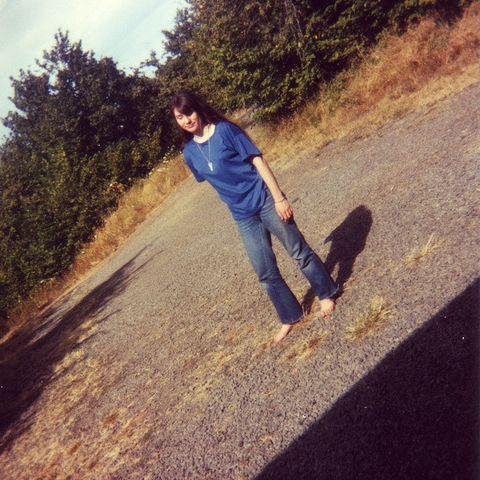

In [68]:
test_img

In [69]:
# Convert image to tensor
img_tensor = torch.Tensor(np.array(test_img)).permute(2, 0, 1)
# Scale pixels values from [0,255] to [0,1]
scaled_tensor = img_tensor.float().div_(255)

In [70]:
input_image = scaled_tensor.unsqueeze(dim=0)
input_image.shape

torch.Size([1, 3, 480, 480])

In [71]:
ir_path

Path('voc-YOLOX.xml')

In [72]:
# Load the network in Inference Engine
ie = Core()
model_ir = ie.read_model(model=ir_path)
model_ir.reshape(input_image.shape)
compiled_model_ir = ie.compile_model(model=model_ir, device_name="CPU")

# Get input and output layers
input_layer_ir = next(iter(compiled_model_ir.inputs))
output_layer_ir = next(iter(compiled_model_ir.outputs))

# Run inference on the input image
res_ir = compiled_model_ir([input_image])[output_layer_ir]

**Benchmark OpenVINO IR CPU inference speed**

In [73]:
%%timeit
compiled_model_ir([input_image])[output_layer_ir]

17.9 ms ± 549 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)


In [74]:
compiled_model_ir([input_image])[output_layer_ir].shape

(1, 4725, 25)

In [75]:
import matplotlib.pyplot as plt
import numpy as np

**Get list of labels without the background class**

In [76]:
labels = parser.class_map.get_classes()[1:]
labels

['aeroplane',
 'bicycle',
 'bird',
 'boat',
 'bottle',
 'bus',
 'car',
 'cat',
 'chair',
 'cow',
 'diningtable',
 'dog',
 'horse',
 'motorbike',
 'person',
 'pottedplant',
 'sheep',
 'sofa',
 'train',
 'tvmonitor']

**Import library for generating color palette**

In [77]:
from distinctipy import distinctipy

**Generate a visually distinct color for each label**

In [78]:
colors = distinctipy.get_colors(len(labels))

**Display the generated color palette**

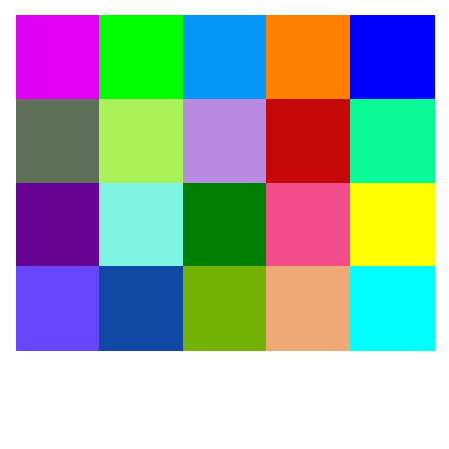

In [79]:
distinctipy.color_swatch(colors)

**Set precision for color values**

In [80]:
precision = 5

**Round color values to specified precision**

In [81]:
colors = [list(np.random.random(size=3).round(precision)) for label in labels]
colors

[[0.07303, 0.80159, 0.26085],
 [0.8018, 0.63869, 0.42966],
 [0.59664, 0.98837, 0.72077],
 [0.74929, 0.19418, 0.45326],
 [0.18146, 0.61166, 0.06512],
 [0.1993, 0.51524, 0.05574],
 [0.03879, 0.10992, 0.4227],
 [0.71397, 0.74201, 0.72599],
 [0.48863, 0.22158, 0.64154],
 [0.22373, 0.7272, 0.74208],
 [0.30026, 0.1048, 0.6694],
 [0.17294, 0.62742, 0.13125],
 [0.20653, 0.50201, 0.75281],
 [0.19052, 0.58091, 0.67853],
 [0.71246, 0.41463, 0.30462],
 [0.9294, 0.13219, 0.39879],
 [0.95918, 0.43141, 0.0611],
 [0.15816, 0.85656, 0.97442],
 [0.39403, 0.75076, 0.09828],
 [0.39646, 0.5173, 0.92961]]

**Create JSON color map**

In [82]:
color_map = {'items': list()}
color_map['items'] = [{'label': label, 'color': color} for label, color in zip(labels, colors)]
color_map

{'items': [{'label': 'aeroplane', 'color': [0.07303, 0.80159, 0.26085]},
  {'label': 'bicycle', 'color': [0.8018, 0.63869, 0.42966]},
  {'label': 'bird', 'color': [0.59664, 0.98837, 0.72077]},
  {'label': 'boat', 'color': [0.74929, 0.19418, 0.45326]},
  {'label': 'bottle', 'color': [0.18146, 0.61166, 0.06512]},
  {'label': 'bus', 'color': [0.1993, 0.51524, 0.05574]},
  {'label': 'car', 'color': [0.03879, 0.10992, 0.4227]},
  {'label': 'cat', 'color': [0.71397, 0.74201, 0.72599]},
  {'label': 'chair', 'color': [0.48863, 0.22158, 0.64154]},
  {'label': 'cow', 'color': [0.22373, 0.7272, 0.74208]},
  {'label': 'diningtable', 'color': [0.30026, 0.1048, 0.6694]},
  {'label': 'dog', 'color': [0.17294, 0.62742, 0.13125]},
  {'label': 'horse', 'color': [0.20653, 0.50201, 0.75281]},
  {'label': 'motorbike', 'color': [0.19052, 0.58091, 0.67853]},
  {'label': 'person', 'color': [0.71246, 0.41463, 0.30462]},
  {'label': 'pottedplant', 'color': [0.9294, 0.13219, 0.39879]},
  {'label': 'sheep', 'colo

In [83]:
dataset_path.name

'voc'

**Export color map**

In [84]:
import json

color_map_file_name = f"{dataset_path.name}-colormap.json"

with open(color_map_file_name, "w") as write_file:
    json.dump(color_map, write_file)
    
color_map_file_name

'voc-colormap.json'

In [85]:
labels_cpp_file_name = f'{dataset_path.name}-labels-cpp.txt'
colormap_cpp_file_name = f'{dataset_path.name}-colormap-cpp.txt'

with open(labels_cpp_file_name, "w") as write_file:
    write_file.write(str(labels).replace("'", '"').replace("[", '{').replace("]", '}'))

with open(colormap_cpp_file_name, "w") as write_file:
    write_file.write(str(colors).replace("'", '"').replace("[", '{').replace("]", '}'))